# <b>Data Diagnostics II </b> *✲ﾟ*｡✧٩(･ิᴗ･ิ๑)۶*✲ﾟ*｡✧

Here we want to investigate Kerem's datasets further, considering that they contained some outliers.

In [1]:

import helper_functions as hf
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns


imputed_dataframe = hf.wbstruct_dataframes.loading_pkl('imputed_dataframe.pkl')
dataframes = hf.wbstruct_dataframes.loading_pkl('dataframes.pkl')
turn_vec = hf.wbstruct_dataframes.loading_pkl('turn_vec.pkl')

In [2]:
datasets = hf.wbstruct_dataframes.loading_pkl('dataframes_rebecca.pkl')
datasets.update(hf.wbstruct_dataframes.loading_pkl('dataframes_kerem.pkl'))

The extreme values that deviate from the expected line at the right end of both QQ-plots might indicate outliers. The distance at which the observations start to deviate drastically from the line seem to be between 12 and 17 for the normal distances and between 20 and 25 for the robust distances, so I would go for a threshold of 12 and 20 respectively for detecting outliers.

In [4]:
# import pkl data
length_dict = hf.defaultdict()
for key, value in datasets.items():
    length_dict[key] = len(value)
length_dict

defaultdict(None,
            {'20200629_w1': 3529,
             '20200708_w3': 3281,
             '20200714_w3': 3505,
             '20200716_w2': 3517,
             '20200724_w3': 3357,
             '20200724_w4': 3529,
             '20200826_w3': 3529,
             '20200826_w6': 3529,
             '20200922_w1': 3529,
             '20200930_w4': 3529,
             '20201007_w4': 3529,
             '20210112_w3': 3529,
             '20210113_w1': 3780,
             '20210126_w2': 3287,
             '20210203_w2': 3287,
             '20210323_w6': 3308,
             '20210324_w5': 3308,
             '20210330_w5': 3113,
             '20210414_w7': 3308,
             'Dataset1_20190125_ZIM1428_Ctrl_w2': 3312,
             'Dataset2_20180207_TKU862_Ctrl_w6': 3749,
             'Dataset3_20180112_TKU761_Ctrl_w1': 4126,
             'Dataset4_20170927_ZIM1428_Ctrl_w7': 5450,
             'Dataset5_20181217_ZIM1428_w2': 3313,
             'Dataset6_20190315_ZIM1428_1xHis_w1': 3311})

In [8]:
df_Kerem = hf.pd.DataFrame()
# we will unstack the dataframe and plot the traces for each dataset

start_index = 0
for dataset,obs_count in length_dict.items():

    # we take the number of observations from the length dictionary and add it to the start index
    end_index = start_index + obs_count
    
    if obs_count == 3749:
        df_Kerem = imputed_dataframe[start_index:end_index] 
    if obs_count == 4126:
        df_Kerem.update(imputed_dataframe[start_index:end_index])
    start_index = end_index
    

In [26]:
list(df_Kerem.columns)[59]

'BAGL'

<Axes: ylabel='BAGL'>

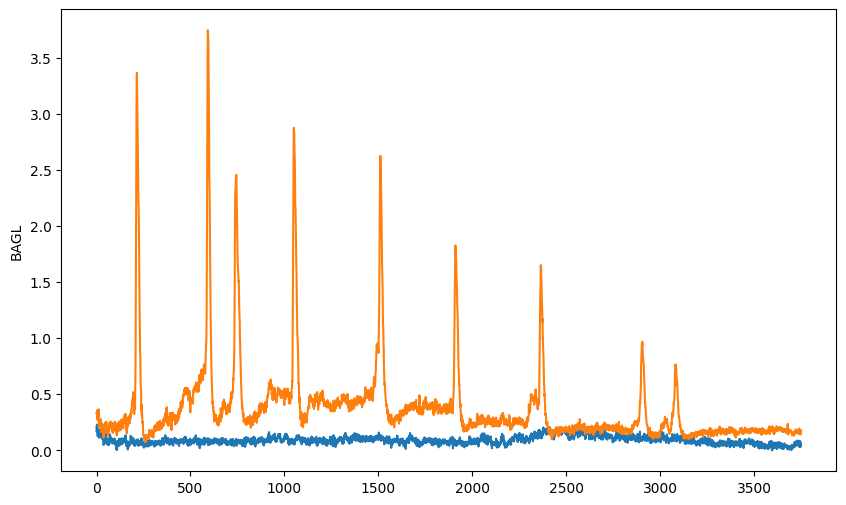

In [28]:
plt.figure(figsize=(10, 6))
sns.lineplot(x=range(len(df_Kerem)), y='BAGL', data=df_Kerem)
sns.lineplot(x=range(len(df_Kerem)), y='SMDVL', data=df_Kerem)

In [173]:
fig = hf.px.scatter(y=MD2_robust_copy["MD2"],x=range(len(MD2_normal)), title='Mahalanobis Distances (Robust)', labels={'x':'Observation', 'y':'MD'}, color=MD2_robust_copy["dataset"], color_continuous_scale='viridis')
fig.update_traces(marker_size=3)
fig.update_layout(legend_title='Dataset')
fig.add_hline(y=19, line_width=2, line_dash="dash", line_color="red")
fig.show()

According to the (normal) Mahalanobis distances on the transformed data there are more diverging observations (delta F over F per time point) at the start of every recording (dataset). So we will work on a truncated dataset that starts at the 100th time point per recording.

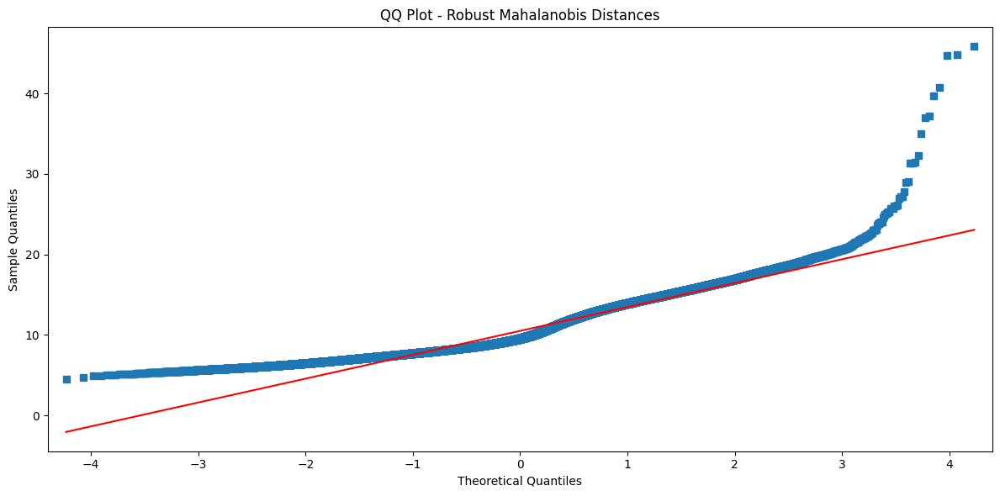

In [15]:
fig, axs = plt.subplots(1, 1, figsize=(12, 6))

dropped = MD2_truncated["MD2"]
dropped.dropna(inplace=True)

# Plot QQ plot for the second dataset
qqplot(dropped, line='s', ax=axs, label='Dataset 2', marker='s')
axs.set_xlabel('Theoretical Quantiles')
axs.set_ylabel('Sample Quantiles')
axs.set_title('QQ Plot - Robust Mahalanobis Distances')

# Adjust layout to prevent clipping of titles
plt.tight_layout()

# Show the figure
plt.show()

In [177]:
fig = hf.px.scatter(y=MD2_truncated["MD2"],x=range(len(MD2_truncated)), title='Mahalanobis Distances (Robust, first 100 frames per dataset removed)', labels={'x':'Observation', 'y':'MD'}, color=MD2_robust_copy["dataset"], color_continuous_scale='viridis')
fig.update_traces(marker_size=3)
fig.update_layout(legend_title='Dataset')
fig.add_hline(y=19, line_width=2, line_dash="dash", line_color="red")
fig.show()

Now we only have a few outliers left. The ones that seem striking are from 2 of Kerem's recordings: Dataset2_20180207_TKU862_Ctrl_w6 and Dataset3_20180112_TKU761_Ctrl_w1. But also one from Rebecca: 20210203_w3. 
We can now check which states these outliers correspond to.

In [176]:
fig = hf.px.scatter(y=MD2_truncated["MD2"],x=range(len(MD2_truncated)), title='Mahalanobis Distances (first 100 frames per dataset removed)', labels={'x':'Observation', 'y':'MD'}, color=turn_vec, color_continuous_scale='viridis')
fig.update_traces(marker_size=3)
fig.update_layout(legend_title='State')
fig.add_hline(y=20, line_width=2, line_dash="dash", line_color="red")
fig.show()

As we can see above, the main outliers are assigned to 'dorsal' and 'ventral' turn. This result coincides with our 3D plot of the principal components where a few observations falling under the 'ventral' and 'dorsal' state were far away from the rest of the data points.


Next we can remove a dataset that seems to yield many of the outliers, one such dataset is Kerem's: 

In [163]:
pca_imputed['state'] = turn_vec

In [166]:
pca_imputed[~((pca_imputed[2]>1.5) & (pca_imputed[0]>2))]

,0,1,2,state
0,2.577036,1.565728,-0.066407,reversal
1,2.518429,1.455871,-0.037225,reversal
2,2.521677,1.508815,0.011063,reversal
3,2.399497,1.155079,-0.042606,reversal
4,2.396890,1.140413,0.000180,reversal
...,...,...,...,...
88539,0.451540,-0.210669,-0.934949,reversal
88540,0.408045,-0.222423,-0.891089,reversal
88541,0.459094,-0.241763,-0.885330,reversal
88542,0.472344,-0.239959,-0.851925,reversal


In [ ]:
outliers_PCA = [index for index in range(len(pca_imputed[2])) if pca_imputed[2].loc[index]>2]
outliers_PCA

In [194]:
transformed_truncated = transformed_data.copy()
transformed_truncated_Keremremoved = imputed_dataframe.copy()

In [195]:
# we will unstack the dataframe and plot the traces for each dataset

start_index = 0
for dataset,obs_count in length_dict.items():

    # we take the number of observations from the length dictionary and add it to the start index
    end_index = start_index + obs_count
    
    if obs_count == 3749:
        transformed_truncated_Keremremoved[start_index:end_index] = np.nan
    transformed_truncated.loc[start_index:start_index+100] = np.nan
    transformed_truncated_Keremremoved.loc[start_index:start_index+100] = np.nan
    start_index = end_index
    count += 1
    
transformed_truncated = transformed_truncated.dropna()
transformed_truncated_Keremremoved = transformed_truncated_Keremremoved.dropna()

In [196]:
transformed_truncated_Keremremoved

,URADL,URADR,URYVR,URYVL,URYDR,URYDL,OLQDL,OLQVL,URAVR,RMED,...,DB01,DA01,DVB,DVC,PDA,AS10,VB11,RIVR,RIBL,SIADR
101,0.146420,0.127379,0.070950,0.107651,0.052365,0.099517,0.214442,0.223336,0.052537,0.123329,...,0.190016,0.472096,0.225842,0.547451,0.179356,0.199814,0.147525,0.147490,0.148582,0.173807
102,0.116353,0.096737,0.055548,0.114646,0.078343,0.056839,0.332199,0.250132,0.055468,0.115764,...,0.209766,0.459451,0.216203,0.550037,0.154703,0.220472,0.174702,0.133438,0.161314,0.170745
103,0.143412,0.085565,0.065909,0.088769,0.054466,0.086051,0.300270,0.257982,0.050940,0.114240,...,0.217080,0.474110,0.200963,0.523542,0.160356,0.196191,0.170525,0.135719,0.134755,0.172612
104,0.126010,0.114220,0.062145,0.128859,0.043263,0.083451,0.279724,0.225275,0.028397,0.112794,...,0.195299,0.449266,0.183969,0.507110,0.166470,0.196863,0.157718,0.125247,0.140383,0.162615
105,0.134179,0.091273,0.067487,0.107878,0.051947,0.093370,0.313425,0.219014,0.068886,0.095357,...,0.187537,0.465045,0.193996,0.501934,0.175241,0.206077,0.141735,0.139415,0.141574,0.163744
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
88539,0.077476,0.074605,0.105581,0.091192,0.070679,0.103842,0.145707,0.039689,0.062157,0.809000,...,0.245616,0.406375,0.225138,0.672917,0.219567,0.316230,0.179771,0.080279,0.035517,0.012778
88540,0.059490,0.069122,0.099761,0.084654,0.026907,0.063788,0.131263,0.040000,0.064451,0.788587,...,0.242059,0.424368,0.224362,0.649443,0.212506,0.304784,0.187481,0.064952,0.048814,0.030170
88541,0.081305,0.079627,0.101710,0.091774,0.073201,0.091530,0.141605,0.053817,0.063094,0.790447,...,0.233480,0.413030,0.222470,0.664735,0.221380,0.307820,0.166993,0.057847,0.038570,0.016279
88542,0.078375,0.076462,0.104614,0.093896,0.066290,0.097600,0.145602,0.063853,0.062570,0.773798,...,0.223214,0.411529,0.216541,0.654919,0.217001,0.311691,0.176433,0.070672,0.051676,0.007106


In [141]:
outliers = [index for index in range(len(MD2_truncated['MD2'])) if MD2_truncated['MD2'].loc[index] >= 20]

In [197]:
%%capture

imputed_df_wooutliers = transformed_truncated_Keremremoved.copy()
turn_vec_wooutliers = hf.get_behavioural_states(imputed_df_wooutliers)


In [198]:
pca = hf.PCA(n_components=3)
imputed_pc_wooutliers = hf.pd.DataFrame(pca.fit_transform(imputed_df_wooutliers))

In [199]:
imputed_pc_wooutliers['state'] = turn_vec_wooutliers.values

In [200]:
plotly_pca,names = hf.utils_plot_traces.modify_dataframe_to_allow_gaps_for_plotly(imputed_pc_wooutliers, [0,1,2] ,'state')

In [201]:
import plotly.graph_objects as go

state_codes = turn_vec.unique()
phase_plot_list = []
for i, state_code in enumerate(state_codes):
    phase_plot_list.append(
                go.Scatter3d(x=plotly_pca[names[0][i]], y=plotly_pca[names[1][i]], z=plotly_pca[names[2][i]], mode="lines",
                                name=state_code))

fig = go.Figure()
fig.add_traces(phase_plot_list)
fig.update_layout(scene = dict(
                    xaxis_title='Mode 1',
                    yaxis_title='Mode 2',
                    zaxis_title='Mode 3'))
fig.write_html("PCA_exploration.html")
fig.show()

In [33]:
pca_imputed = hf.pd.read_pickle('pca_imputed_data.pkl')

In [49]:
pca_imputed.loc[72557,:]

0    1.518746
1    0.557662
2    0.739869
Name: 72557, dtype: float64

In [44]:
pca_imputed[pca_imputed[2] > 2]

,0,1,2
68808,3.217021,1.446681,2.163279
68809,2.991995,1.478339,2.392795
68810,2.727551,1.478664,2.507188
68811,2.409640,1.362843,2.563869
68812,2.198853,1.374745,2.561530
...,...,...,...
70107,1.823585,1.291213,2.106263
70108,1.571157,1.190915,2.061708
70109,1.304474,1.139042,2.062909
70110,1.080751,1.053073,2.028874


### Appendix I: Thoughts on automated Behavioural State Annotation

Since there are no behavioural state annotations in the original wbstruct data from Rebecca and Kerem we applied a function (see helper_functions) that computes the state as described in the exploration_visualization notebook and the @approximate_turn_annotations_using_ids function from wbfm.
The function now assigns to an observation the state 'reversal' not only if AVAL is in the state 'high' but also in 'rise'.
Following is a plot of all 88k+ observations for the neuron RIML with a color encoding based on the state and this plot shows that there might be some errouneous state annotations. E.g. zoom in on observations 30 267, there are just a few reversals in between forward ones. 

In [59]:
hf.px.scatter(imputed_dataframe, y="RIML", color=turn_vec, color_continuous_scale='viridis', marginal_y='histogram').show()